In [24]:
import sklearn 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import plotly.express as px
import plotly.graph_objects as go
import os

In [36]:
class KDE():    
    '''Implement kernel density estimation (KDE) using Gaussian , box and triangular kernel.'''
    def __init__(self, bandwidth=1, kernel='gaussian'):
        self.bandwidth = bandwidth
        self.kernel = kernel
        self.x_train = None
        self.dim = None
    
    def fit(self, X):
        '''X is of the shape (n,m) where n is the number of samples and m is the dimension'''
        self.x_train = X
        self.dim = X.shape[1]
    
    def gaussian_kernel(self, x):
        '''Gaussian kernel.'''
        # gauss = (1 / (2*np.pi)**(self.dim/2)) * np.exp(-0.5*(np.matmul(x, x.T)))
        n = x.shape[0]
        gauss = np.zeros((n,1))
        for i in range(n):
            gauss[i] = (1 / (2*np.pi)**(self.dim/2)) * np.exp(-0.5*(np.matmul(x[i,:], x[i,:].T)))
       
        return gauss
    
    def box_kernel(self, x):
        '''Box kernel.'''
        # return 1 if |x| < 1/2  , else 0 where x is d dimensional vector
        mag_x = np.sqrt(np.sum(x*x))
        if mag_x < 0.5:
            return 1
        else:
            return 0
    
    def predict1(self, x):
        sumval = 0
        if self.kernel == 'gaussian':
            sumval = np.sum(self.gaussian_kernel((x - self.x_train)/self.bandwidth), axis=0)
        elif self.kernel == 'box':
            sumval = np.sum(self.box_kernel((x - self.x_train)/self.bandwidth), axis=0)
        else:
            raise ValueError('Kernel not supported.')
        return sumval / (self.x_train.shape[0] * (self.bandwidth**self.dim))
    
    def predict(self, X):
        '''X is of the shape (n,m) where n is the number of samples and m is the dimension'''
        return np.array([self.predict1(x) for x in X])
    
    def pseudolikelihood(self):
        # exclude ith dataset point from the dataset and calculate the density of that point using the rest of the dataset
        # then sum up the log of the densities of all the points
        densities = []
        for i in range(self.x_train.shape[0]):
            x_temp = self.x_train
            self.x_train = np.delete(self.x_train, i, axis=0)
            densities.append(np.log(self.predict1(x_temp[i,:])))
            self.x_train = x_temp
        
        score = np.sum(densities)/self.x_train.shape[0]
        return score


    def visualisedata(self , X):
        '''X is of the shape (n,m) where n is the number of samples and m is the dimension'''
        ''' m <= 2'''
        if self.dim > 2:
            raise ValueError('Dimension greater than 2. Cannot visualize.')
        else:
            dens = self.predict(X)
            if self.dim == 1:

                # plot a graph with x_train points as dots on x axis and density of X on y axis
                # show clear marking on the x axis for x_train points
                # make a wide plot and show all the points on x axis clearly
                plt.scatter(self.x_train, np.zeros(self.x_train.shape[0]), c='r', s=10)
                plt.scatter(X, dens, c='b', s=10)
                plt.show()
                plt.close()
                

            elif self.dim == 2:
                # plot a 3d graph with x_train points as dots on x-y plane and density of X on z axis
                fig = plt.figure()
                ax = fig.add_subplot(111, projection='3d')
                ax.scatter(self.x_train[:,0], self.x_train[:,1], np.zeros(self.x_train.shape[0]), c='r', s=10)
                ax.scatter(X[:,0], X[:,1], dens, c='g', s=10)
                plt.show()

In [37]:
def create_data(n=100, d=1):
    '''Create some random data of shape (n,d)'''
    return np.random.randn(n, d)

data = create_data(100, 2)


Best bandwidth:  0.6


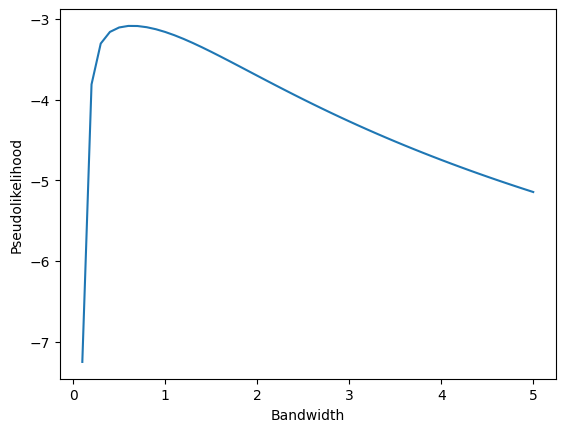

In [38]:
def calculate_pseudolikelihood(data, bandwidths):
    scores = []
    for b in bandwidths:
        kde = KDE(bandwidth=b, kernel='gaussian')
        kde.fit(data)
        scores.append(kde.pseudolikelihood())
    return scores

bandwidths = np.linspace(0.1, 5, 50)
scores = calculate_pseudolikelihood(data, bandwidths)

plt.plot(bandwidths, scores)
plt.xlabel('Bandwidth')
plt.ylabel('Pseudolikelihood')

best_bandwidth = bandwidths[np.argmax(scores)]
print("Best bandwidth: ", best_bandwidth)


In [39]:
kde = KDE(bandwidth=best_bandwidth, kernel='gaussian')
kde.fit(data)


In [40]:
x_sample = [-0.6, 2.1]
dens = kde.predict1(x_sample)
dens


array([0.02838492])

In [41]:
def create_2d_grid(x_range, y_range, num_points):
    x = np.linspace(x_range[0], x_range[1], num_points)
    y = np.linspace(y_range[0], y_range[1], num_points)
    X, Y = np.meshgrid(x, y)
    return np.vstack((X.flatten(), Y.flatten())).T

X_sample = create_2d_grid((-3, 3), (-3, 3), 50)
dens = kde.predict(X_sample)
dens.shape


(2500, 1)

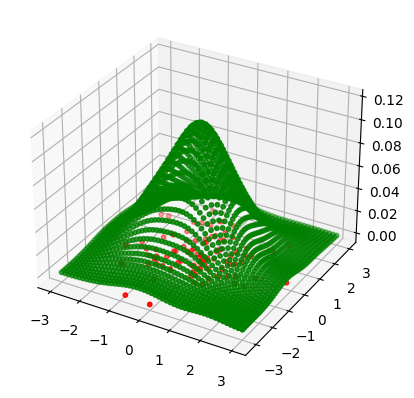

In [43]:
kde.visualisedata(X_sample)

## Task 2

In [48]:
IMG_DIR = 'data/doc_images'
CSV_DIR = 'data/doc_csv'

In [64]:
def visualize_bboxes(img , df):
  img_2 = img.copy()
  for index, rows in df.iterrows():
    top_left = (int(rows['Top-Left'].split(',')[0][1:]),int(rows['Top-Left'].split(',')[1][:-1]))
    bottom_right = (int(rows['Bottom-Right'].split(',')[0][1:]),int(rows['Bottom-Right'].split(',')[1][:-1]))
    # print(top_left)
    cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)

  plt.imshow(img_2)
  plt.show()
  plt.close()

In [65]:
def make_connections(image , euclidean):

  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  image_with_boxes = image_rgb.copy()

  for index, row in euclidean.iterrows():
      left = int(row['Left'][0])
      right = int(row['Right'][0])
      top = int(row['Top'][1])
      bottom = int(row['Bottom'][1])
      box_id = int(row['Id'])

      width = right - left
      height = bottom - top

      top_left = (left, top)
      bottom_right = (right, bottom)

      cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

      label_position = (left, top - 10)
      cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

      top_adjacent_id = int(row['Top_Box'][1])
      bottom_adjacent_id = int(row['Bottom_Box'][1])
      left_adjacent_id = int(row['Left_Box'][1])
      right_adjacent_id = int(row['Right_Box'][1])

      if top_adjacent_id != 0:
          top_adjacent_row = euclidean[euclidean['Id'] == top_adjacent_id].iloc[0]
          top_adjacent_center = int(top_adjacent_row['Bottom'][0]) , int(top_adjacent_row['Bottom'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 255, 0), 2)

      if bottom_adjacent_id != 0:
          bottom_adjacent_row = euclidean[euclidean['Id'] == bottom_adjacent_id].iloc[0]
          bottom_adjacent_center = int(bottom_adjacent_row['Top'][0]) , int(bottom_adjacent_row['Top'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)), (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 255, 0), 2)

      if left_adjacent_id != 0:
          left_adjacent_row = euclidean[euclidean['Id'] == left_adjacent_id].iloc[0]
          left_adjacent_center = int(left_adjacent_row['Right'][0]) , int(left_adjacent_row['Right'][1])
          cv2.line(image_with_boxes, (int(left), int(top) + height // 2), (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 255, 0), 2)

      if right_adjacent_id != 0:
          right_adjacent_row = euclidean[euclidean['Id'] == right_adjacent_id].iloc[0]
          right_adjacent_center = int(right_adjacent_row['Left'][0]) , int(right_adjacent_row['Left'][1])
          cv2.line(image_with_boxes, (int(right), int(top) + height // 2), (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 255, 0), 2)

  return image_with_boxes

In [66]:
def generate_euclidean(X_trans , X , thresh):
    data = []
    columns = ['Id','Top','Bottom','Left','Right', 'Top_Box', 'Bottom_Box', 'Left_Box','Right_Box' ]
    for i in range(X_trans.shape[0]):
        top_box = [np.inf , -1]
        bottom_box = [np.inf , -1]
        right_box = [np.inf , -1]
        left_box = [np.inf , -1]

        top_box_indices = np.where(X_trans[: , 1] < X_trans[i][1])[0]
        bottom_box_indices = np.where(X_trans[: , 1] > X_trans[i][1])[0]
        right_box_indices = np.where(X_trans[: , 0] > X_trans[i][0])[0]
        left_box_indices = np.where(X_trans[: , 0] < X_trans[i][0])[0]

        for index in top_box_indices:
            dis = np.sqrt((X_trans[index][0] - X_trans[i][0]) ** 2 + (X_trans[index][1] - X_trans[i][1]) ** 2)
            if(dis < top_box[0] and dis < thresh[1]):
                top_box = [dis , index]

        for index in bottom_box_indices:
            dis = np.sqrt((X_trans[index][0] - X_trans[i][0]) ** 2 + (X_trans[index][1] - X_trans[i][1]) ** 2)
            if(dis < bottom_box[0] and dis < thresh[1]):
                bottom_box = [dis , index]

        for index in right_box_indices:
            dis = np.sqrt((X_trans[index][0] - X_trans[i][0]) ** 2 + (X_trans[index][1] - X_trans[i][1]) ** 2)
            if(dis < right_box[0] and dis < thresh[0]):
                right_box = [dis , index]

        for index in left_box_indices:
            dis = np.sqrt((X_trans[index][0] - X_trans[i][0]) ** 2 + (X_trans[index][1] - X_trans[i][1]) ** 2)
            if(dis < left_box[0] and dis < thresh[0]):
                left_box = [dis , index]  

        if(top_box[1] == -1):
            top_box = [-1,0]

        if(right_box[1] == -1):
            right_box = [-1,0]

        if(left_box[1] == -1):
            left_box = [-1,0]

        if(bottom_box[1] == -1):
            bottom_box = [-1,0]

        top_left = [int(X[i][0].split(',')[0][1:]),int(X[i][0].split(',')[1][:-1])]
        bottom_right = [int(X[i][1].split(',')[0][1:]),int(X[i][1].split(',')[1][:-1])]

        top_edge = [(top_left[0] + bottom_right[0])//2 , top_left[1]]
        bottom_edge = [(top_left[0] + bottom_right[0])//2 , bottom_right[1]]
        left_edge = [top_left[0] , (top_left[1] + bottom_right[1])//2]
        right_edge = [bottom_right[0] , (top_left[0] + bottom_right[0])//2]

        data.append([i , top_edge , bottom_edge , left_edge , right_edge , top_box , bottom_box , left_box , right_box])
    
    euclidean = pd.DataFrame(data , columns=columns)
    return euclidean


In [89]:
def find_threshold(bandwidth, X_trans, axis_index, density_threshold, max_range, plot_title):
    visualising_points = np.linspace(0, max_range, max_range).reshape(-1, 1)
    kde = KDE(bandwidth=bandwidth, kernel='gaussian')
    kde.fit(X_trans[:, axis_index].reshape(-1, 1))
    print(plot_title)
    kde.visualisedata(visualising_points)
    densities = kde.predict(visualising_points)
    less_dense = np.where(densities < density_threshold)[0]
    diff_next = np.diff(less_dense)
    diff_prev = np.diff(less_dense, prepend=0)
    start_pts = np.where(diff_next > 5)[0]
    end_pts = np.where(diff_prev > 5)[0]
    threshold = np.mean(less_dense[end_pts] - less_dense[start_pts]).astype('int')
    return threshold

In [90]:
def find_combined_threshold(bandwidth, X_trans):
    x_threshold = find_threshold(bandwidth[0], X_trans, 0, 0.0001, 3000, 'X threshold kernel density plot')
    y_threshold = find_threshold(bandwidth[1], X_trans, 1, 0.0005, 4000, 'Y threshold kernel density plot')
    return [y_threshold, x_threshold]


In [85]:
def get_x_trans(x):
    num_points = x.shape[0]
    x_trans = np.zeros((x.shape[0] , 2))
    for i in range(num_points):
        top_left_1 = [int(x[i][0].split(',')[0][1:]),int(x[i][0].split(',')[1][:-1])]
        bottom_right_1 = [int(x[i][1].split(',')[0][1:]),int(x[i][1].split(',')[1][:-1])]
        center_1 = [(top_left_1[0] + bottom_right_1[0]) // 2, (top_left_1[1] + bottom_right_1[1]) // 2]
        x_trans[i] = np.array(center_1).astype('float')
    return x_trans

In [91]:
def plotresults(config, img_name):
    img_path = os.path.join(IMG_DIR, img_name + '.jpg')
    csv_path = os.path.join(CSV_DIR, 'TLBR_' + img_name + '.csv')
    img_csv = pd.read_csv(csv_path)
    image = cv2.imread(img_path)
    x = img_csv.iloc[:, 1:4].values
    x_trans = get_x_trans(x)
    thresh = find_combined_threshold(config, x_trans)
    print("Thresholds are:", thresh)
    euclidean = generate_euclidean(x_trans , x , thresh)
    image_with_boxes = make_connections(image , euclidean)
    print("Image with boxes")
    visualize_bboxes(image , img_csv)
    print("Final Result")
    fig , ax = plt.subplots(1 , 2 , figsize=(20 , 10))
    ax[0].imshow(image)
    ax[0].set_title('Original Image')
    ax[1].imshow(image_with_boxes)
    ax[1].set_title('Image with Connections')
    plt.show()
    plt.close()
    

In [87]:
x_bandwidth = [10 , 20 , 30 , 50]
y_bandwidth = [1 , 5 , 10 , 20 ]
num_configs = len(x_bandwidth)

____________________________Image 29____________________________
Config: [10, 1]
X threshold kernel density plot


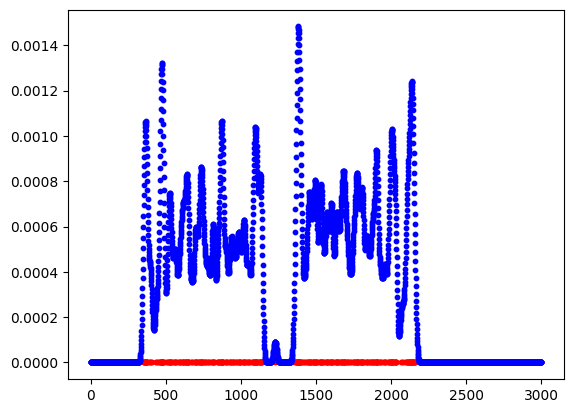

Y threshold kernel density plot


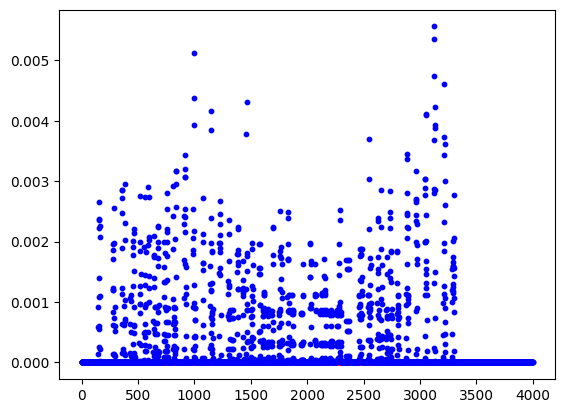

Thresholds are: [9, 822]
Image with boxes


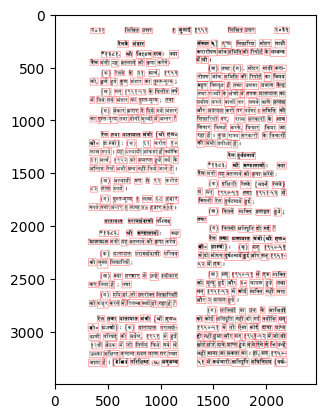

Final Result


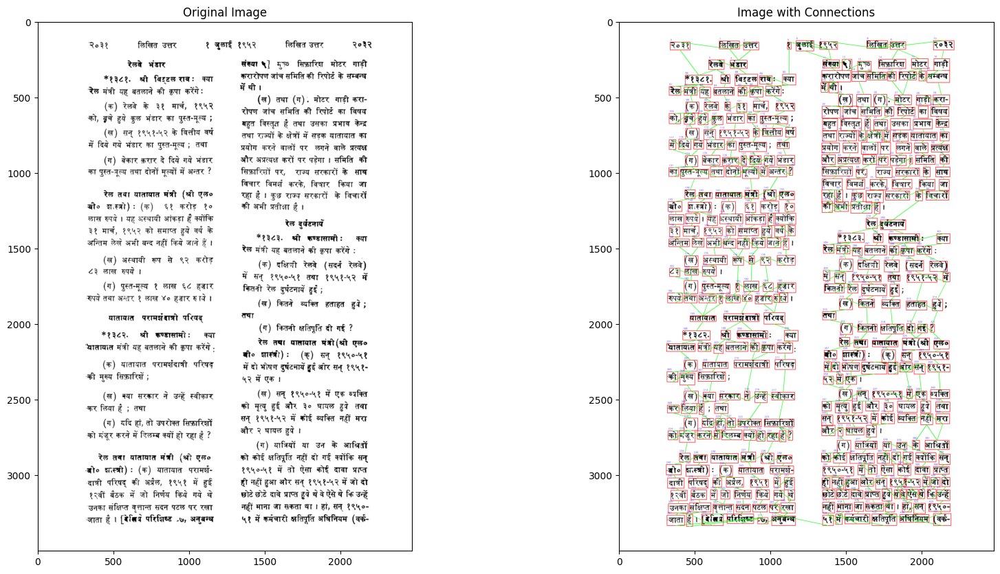

Config: [20, 5]
X threshold kernel density plot


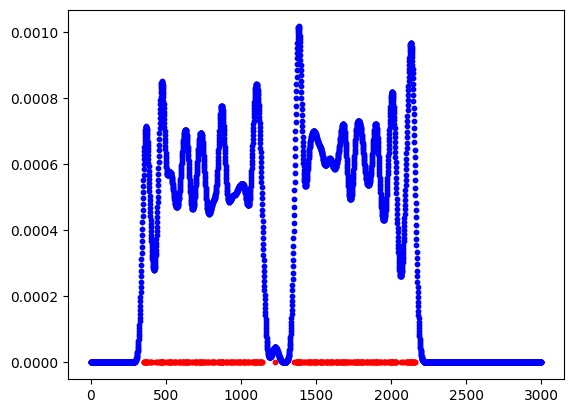

Y threshold kernel density plot


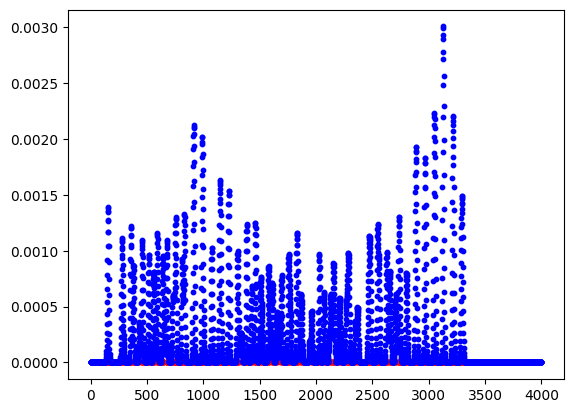

Thresholds are: [18, 849]
Image with boxes


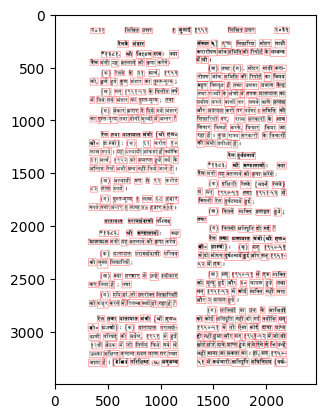

Final Result


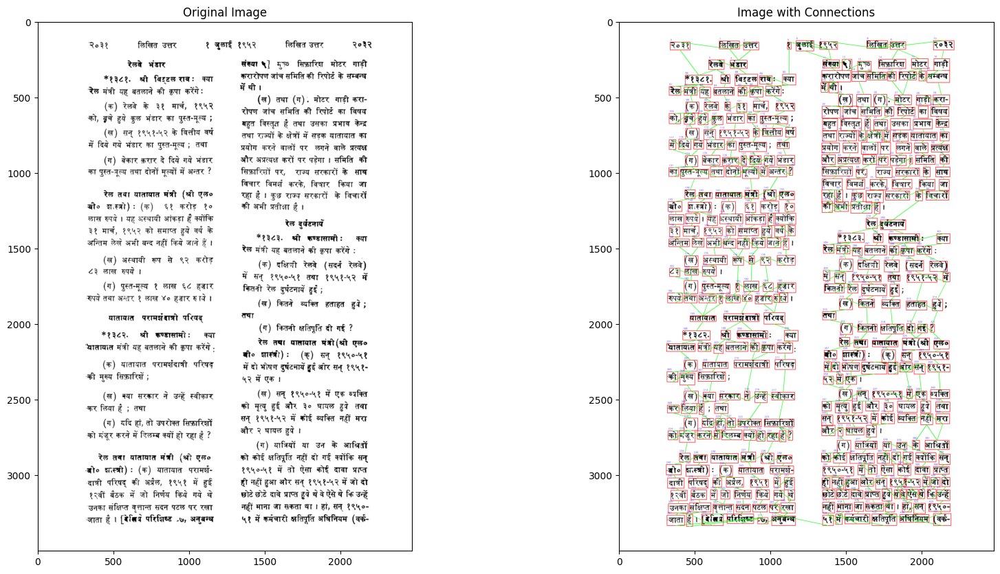

Config: [30, 10]
X threshold kernel density plot


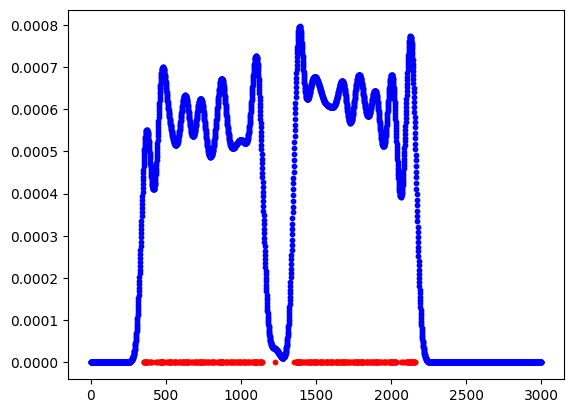

Y threshold kernel density plot


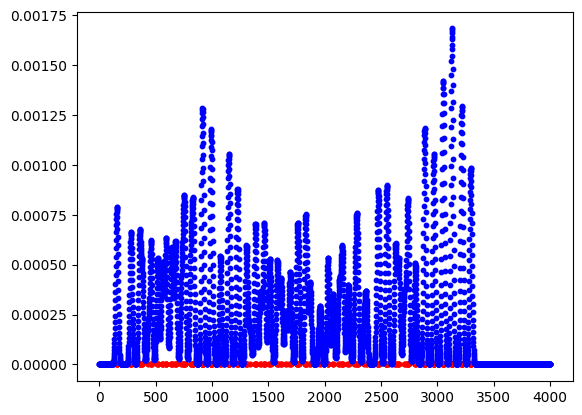

Thresholds are: [21, 876]
Image with boxes


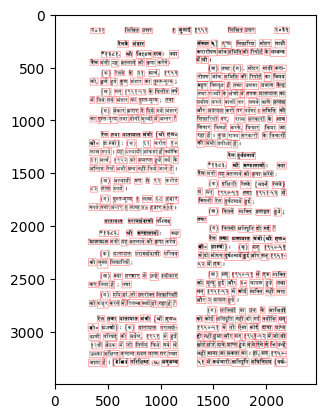

Final Result


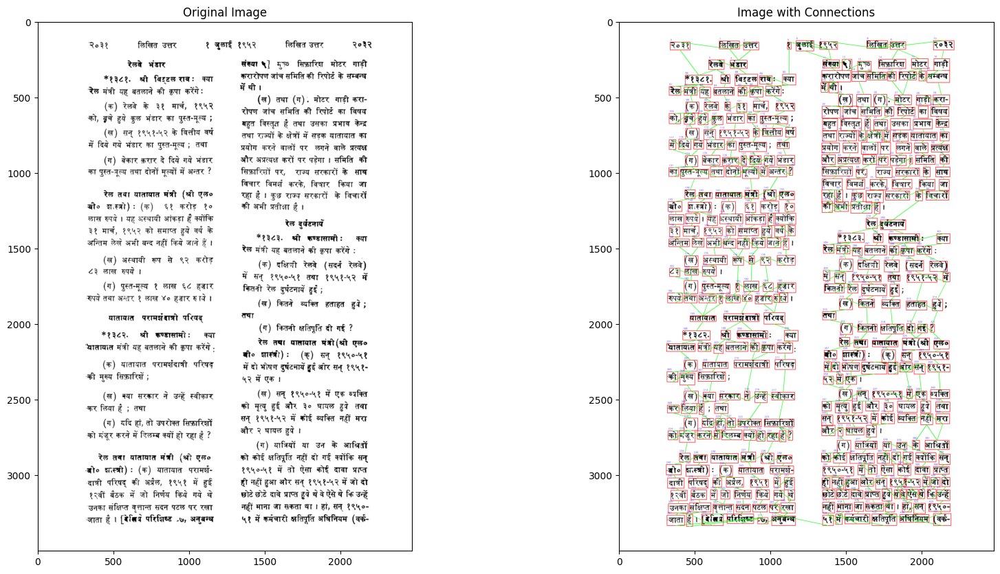

Config: [50, 20]
X threshold kernel density plot


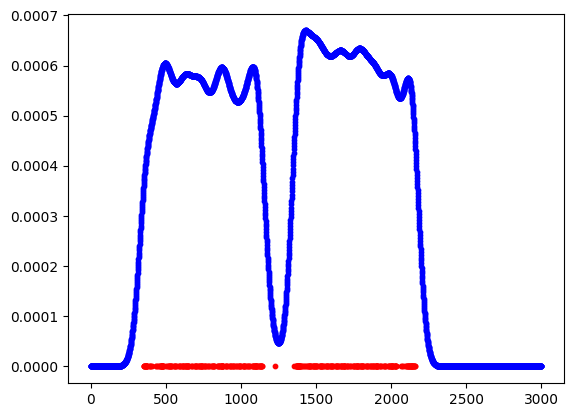

Y threshold kernel density plot


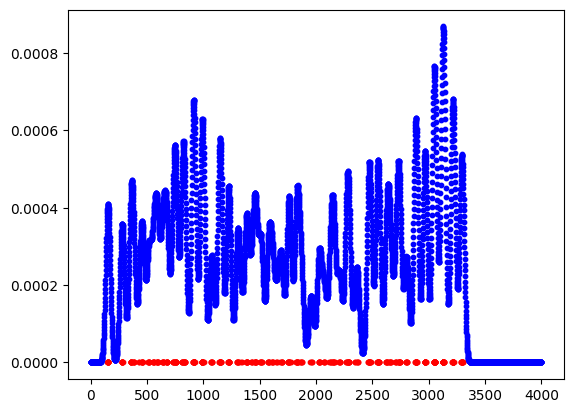

Thresholds are: [26, 928]
Image with boxes


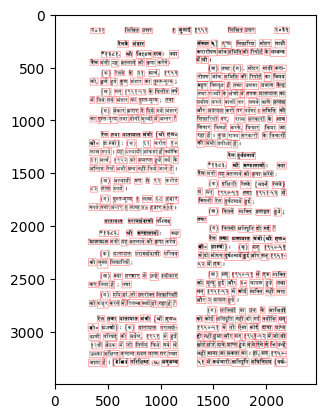

Final Result


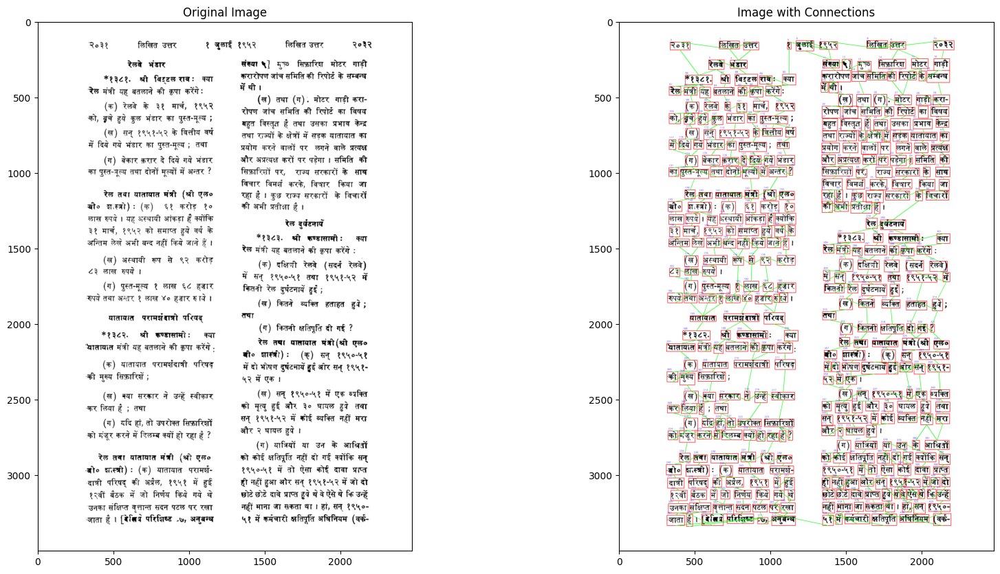

____________________________Image 68____________________________
Config: [10, 1]
X threshold kernel density plot


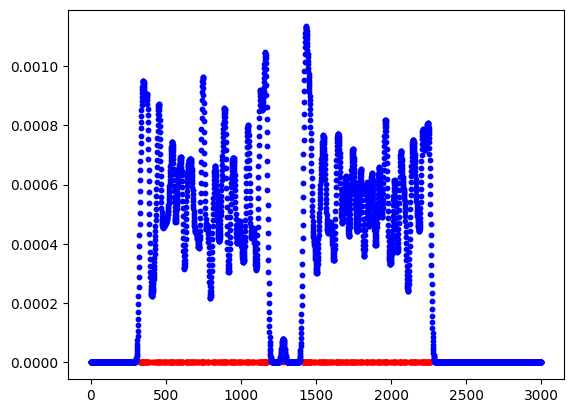

Y threshold kernel density plot


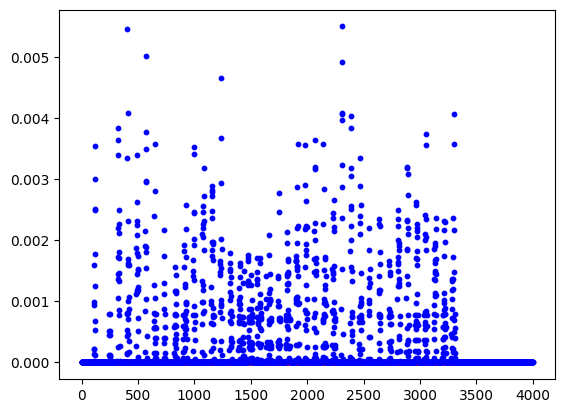

Thresholds are: [11, 877]
Image with boxes


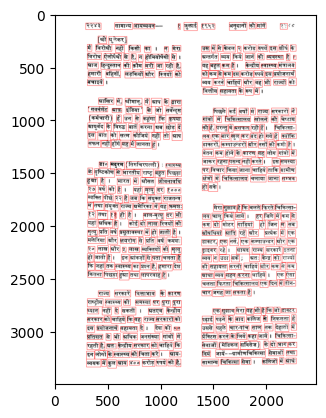

Final Result


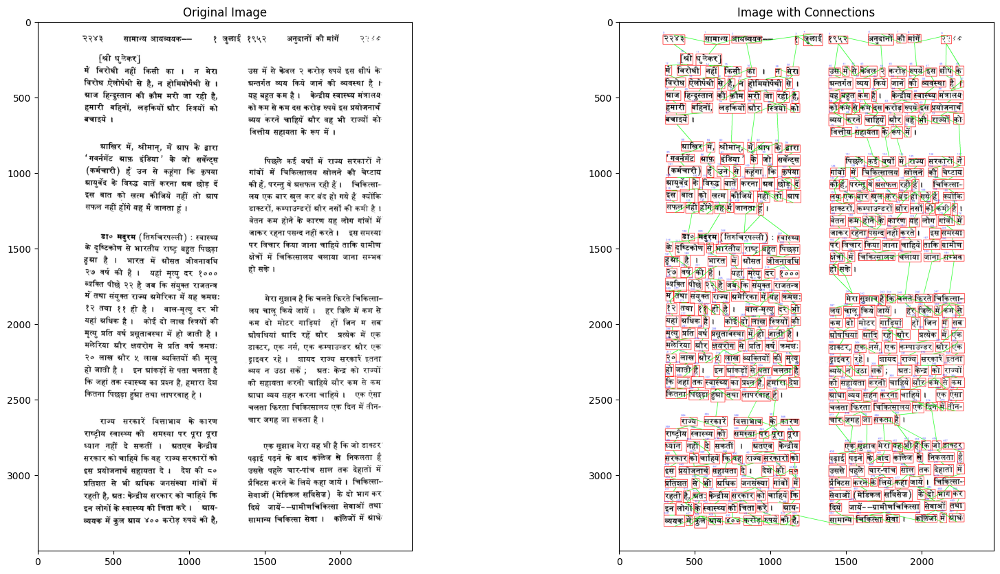

Config: [20, 5]
X threshold kernel density plot


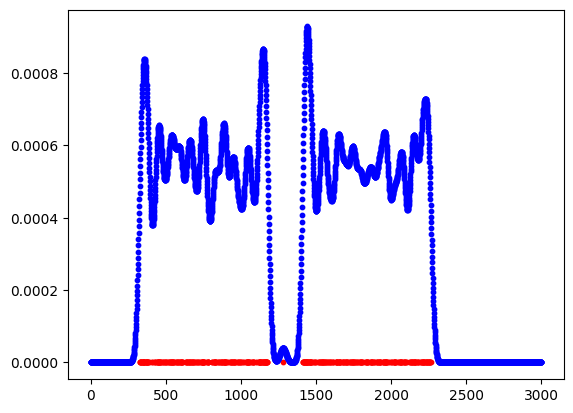

Y threshold kernel density plot


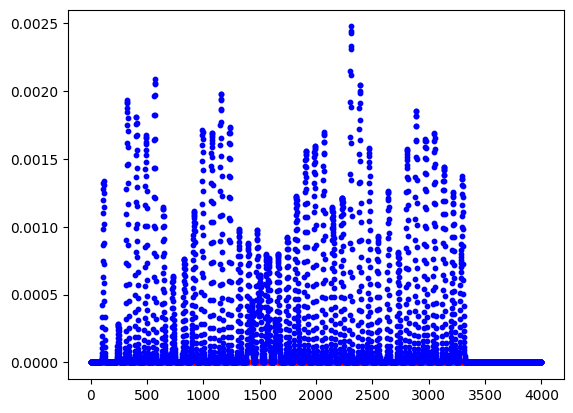

Thresholds are: [20, 902]
Image with boxes


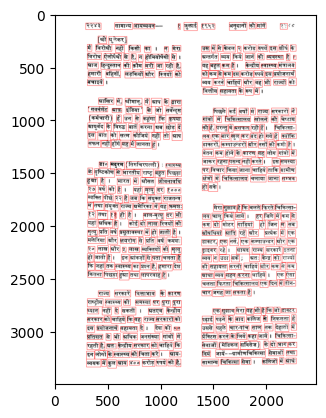

Final Result


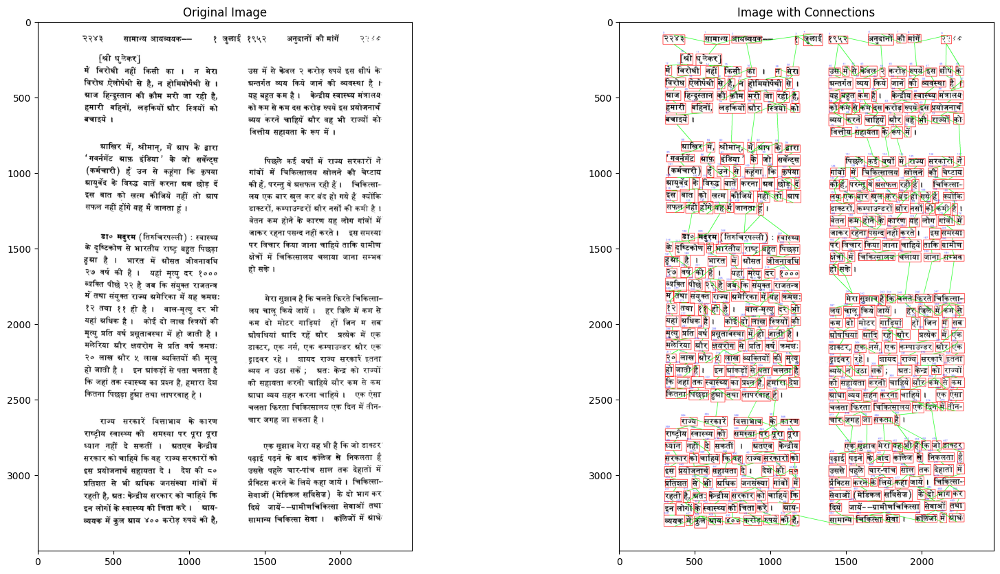

Config: [30, 10]
X threshold kernel density plot


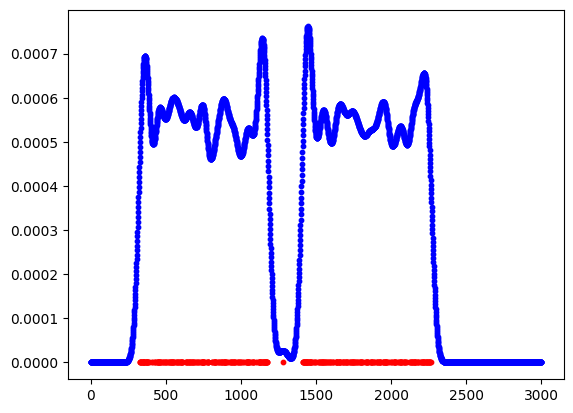

Y threshold kernel density plot


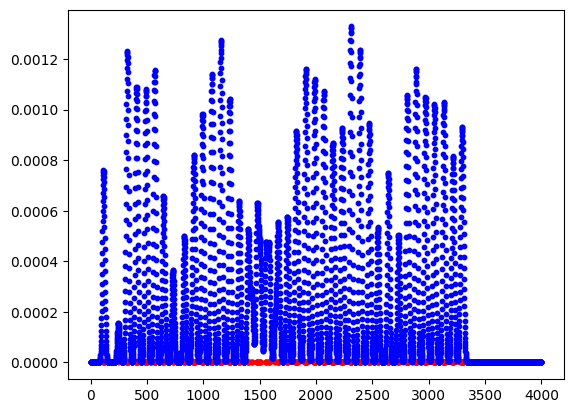

Thresholds are: [25, 928]
Image with boxes


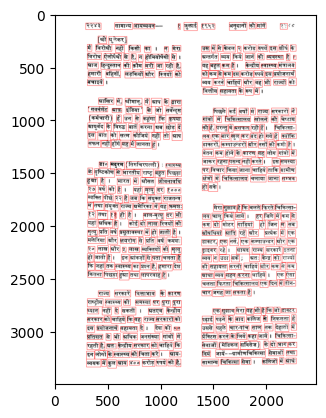

Final Result


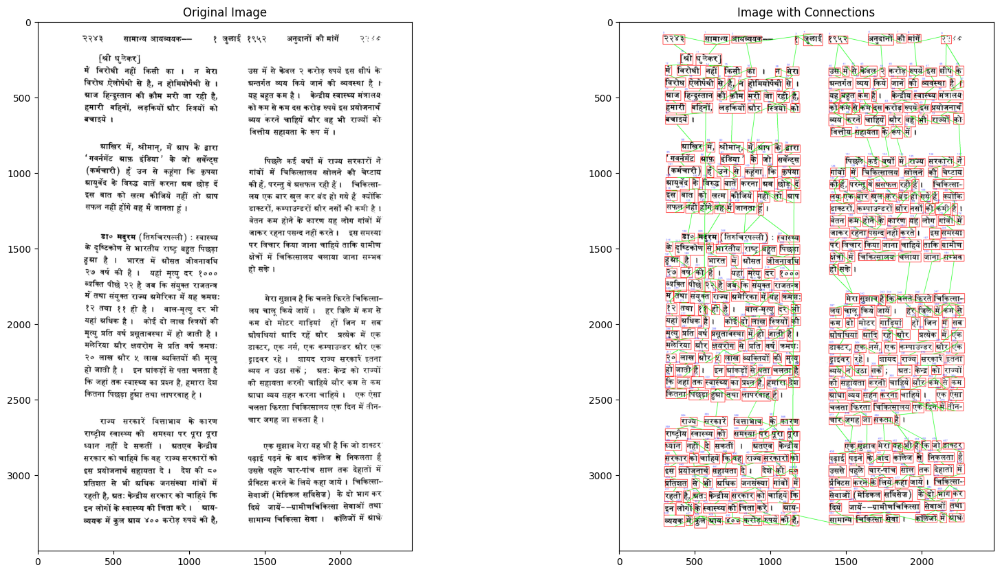

Config: [50, 20]
X threshold kernel density plot


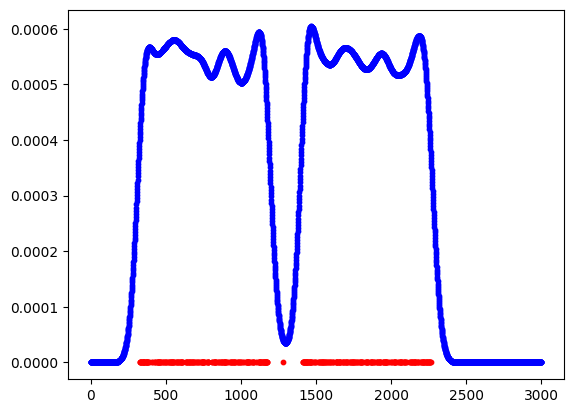

Y threshold kernel density plot


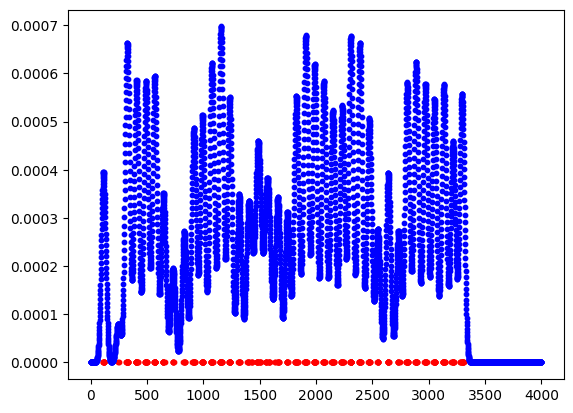

Thresholds are: [23, 978]
Image with boxes


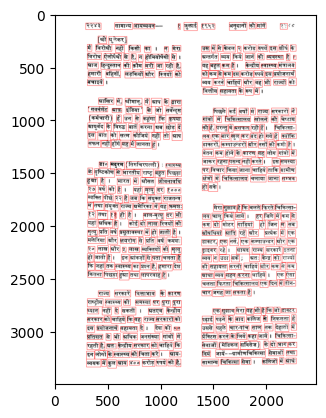

Final Result


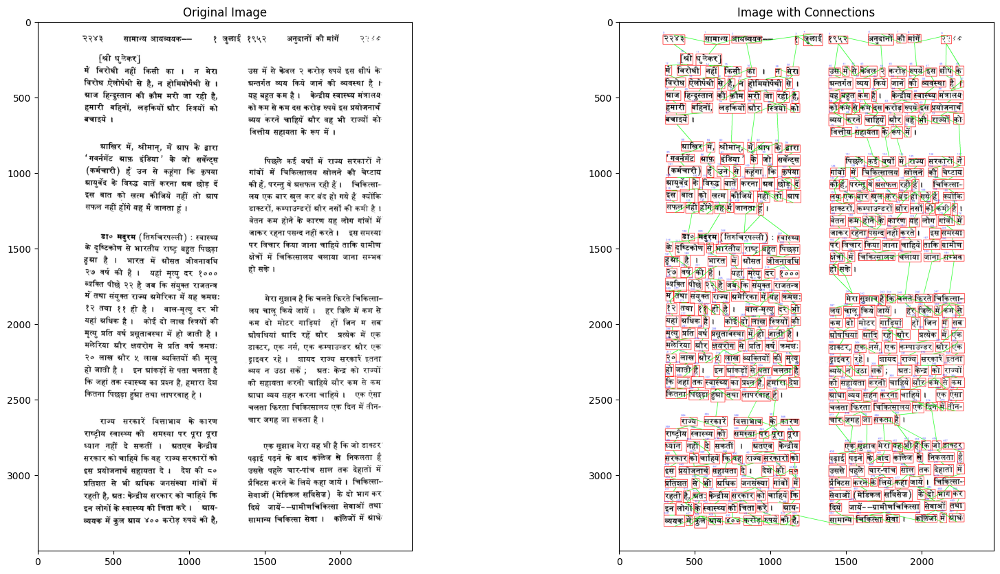

____________________________Image 145____________________________
Config: [10, 1]
X threshold kernel density plot


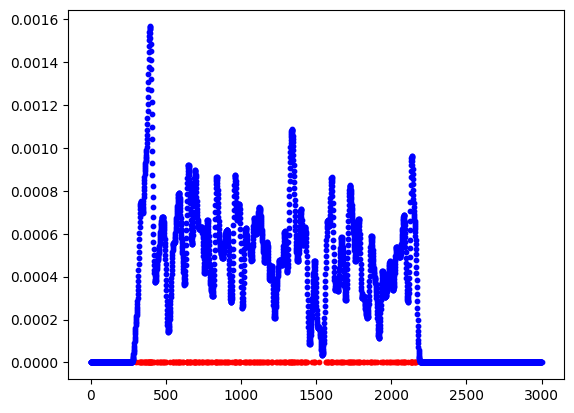

Y threshold kernel density plot


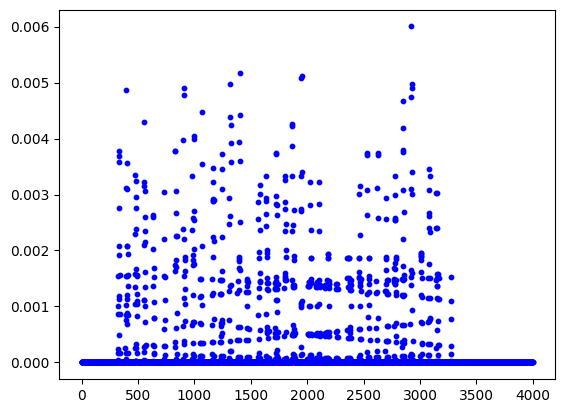

Thresholds are: [9, 620]
Image with boxes


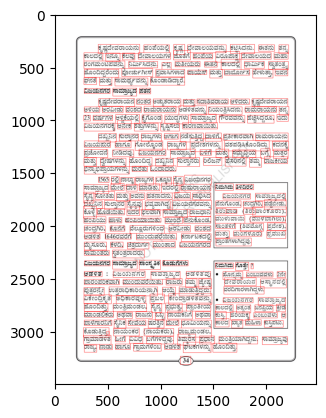

Final Result


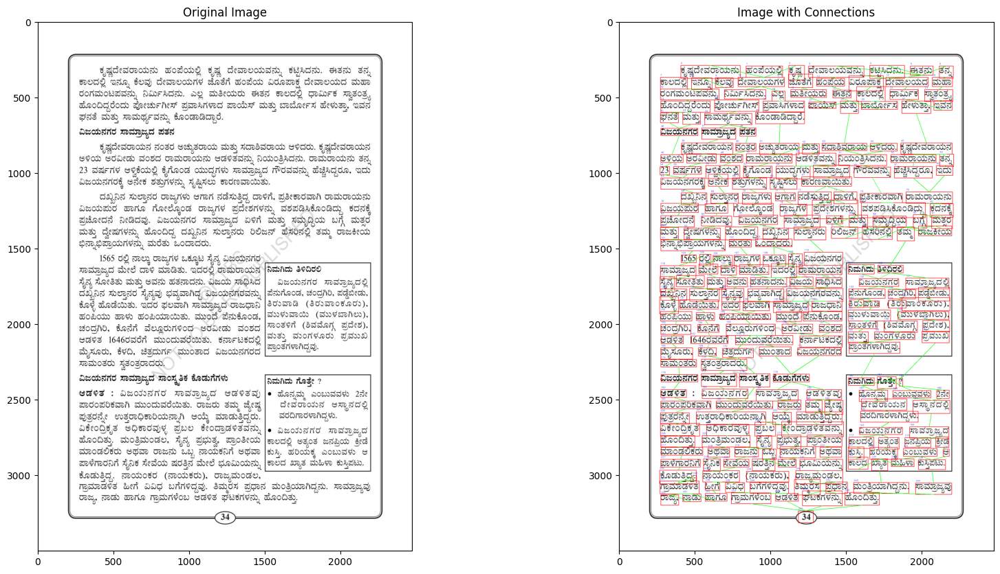

Config: [20, 5]
X threshold kernel density plot


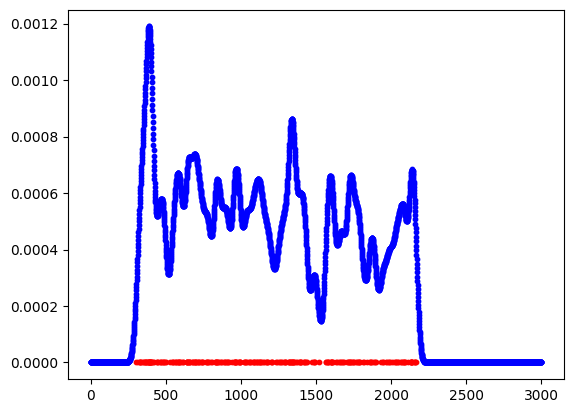

Y threshold kernel density plot


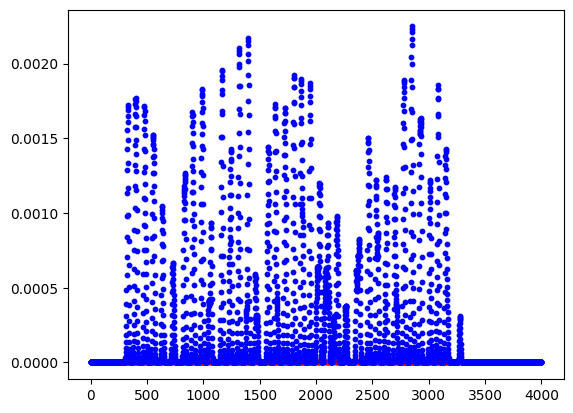

Thresholds are: [21, 1904]
Image with boxes


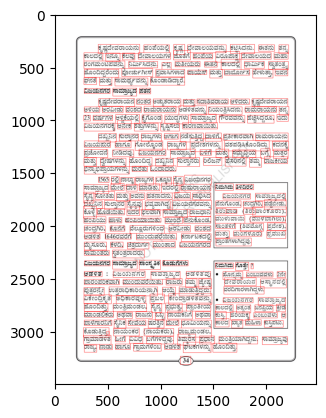

Final Result


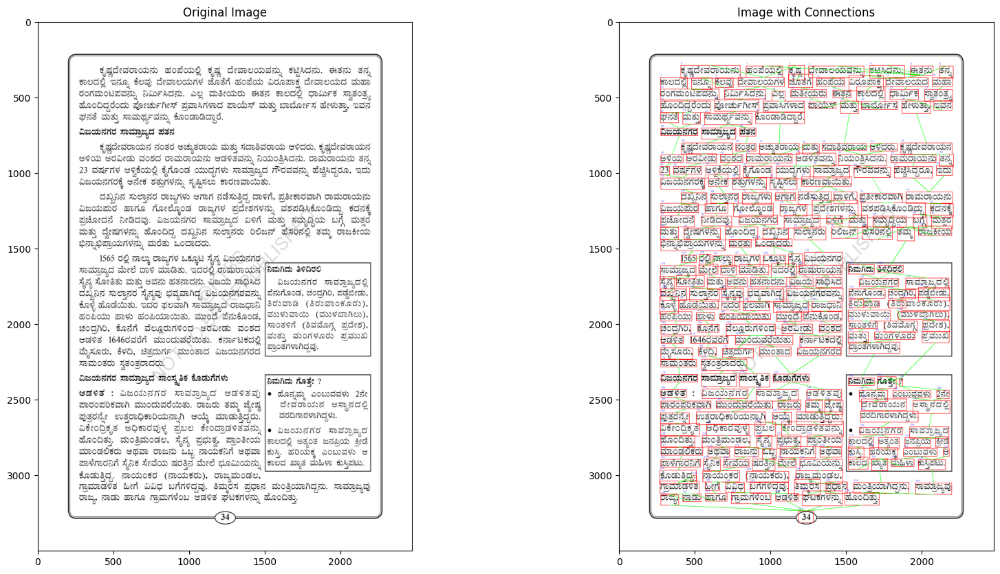

Config: [30, 10]
X threshold kernel density plot


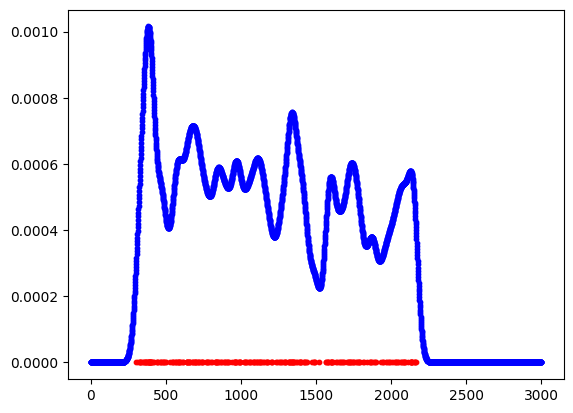

Y threshold kernel density plot


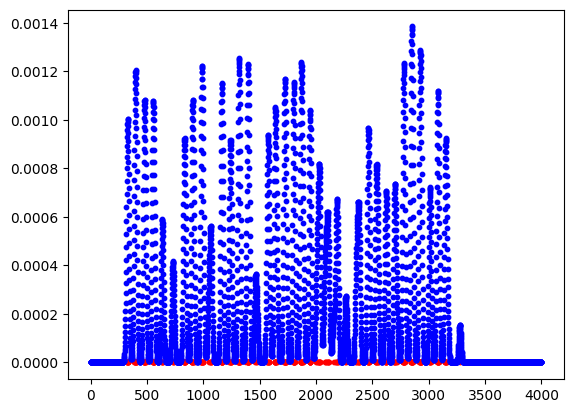

Thresholds are: [27, 1926]
Image with boxes


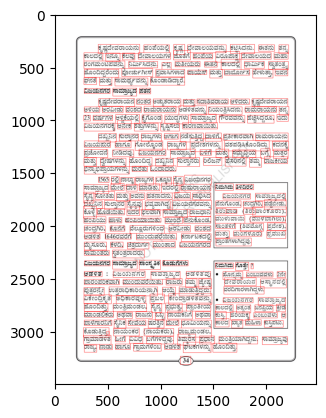

Final Result


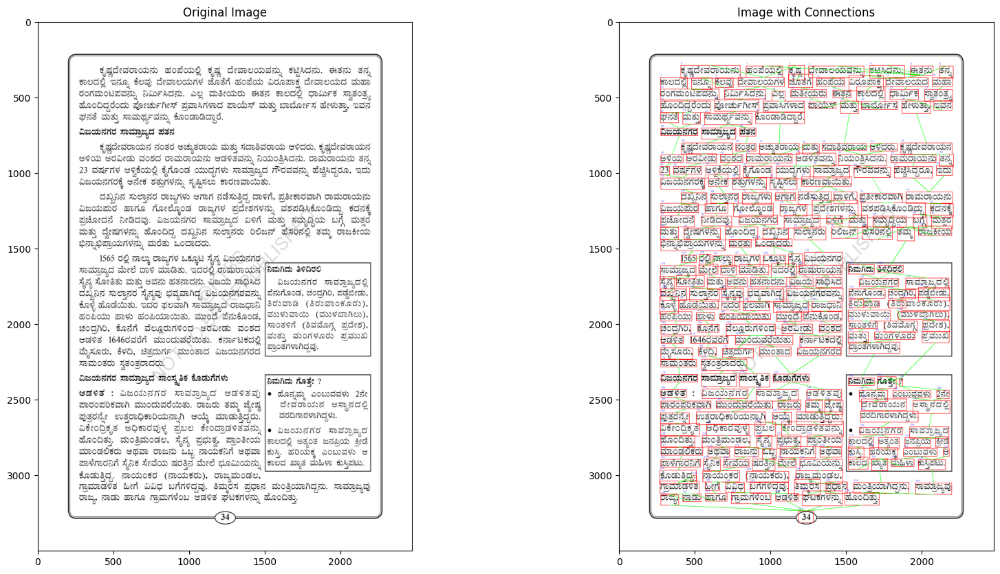

Config: [50, 20]
X threshold kernel density plot


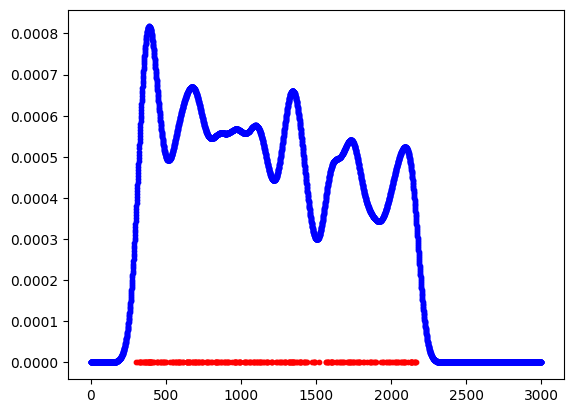

Y threshold kernel density plot


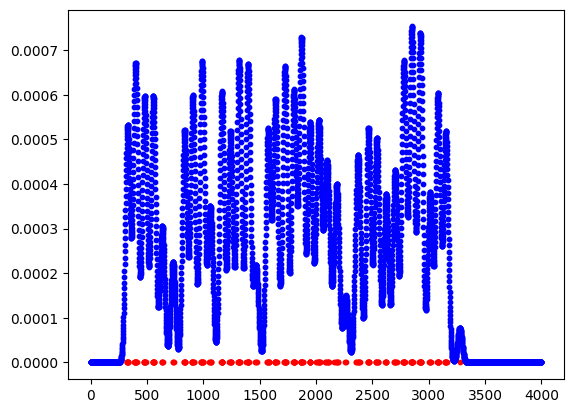

Thresholds are: [25, 1970]
Image with boxes


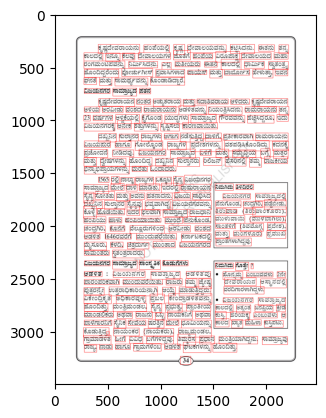

Final Result


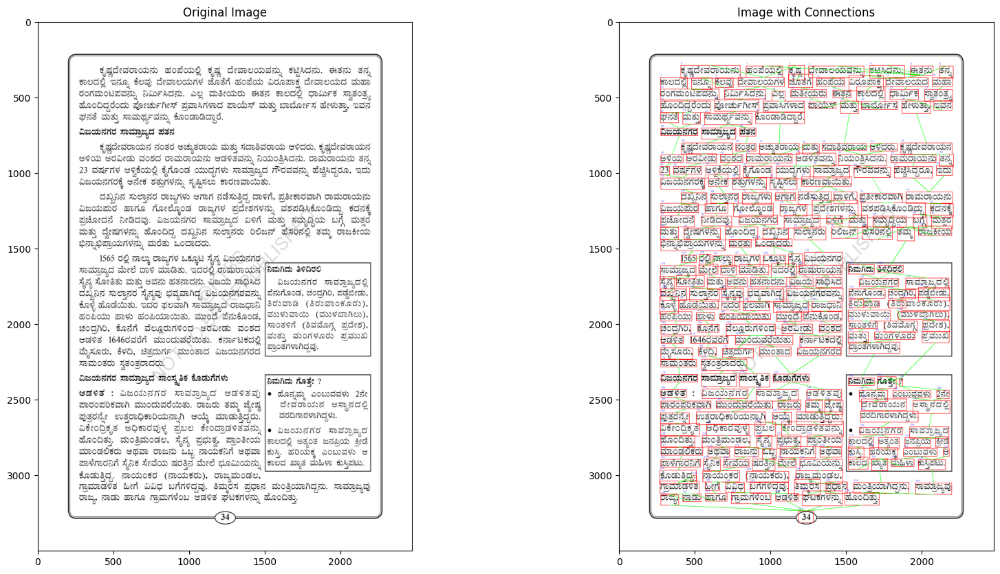

____________________________Image 201____________________________
Config: [10, 1]
X threshold kernel density plot


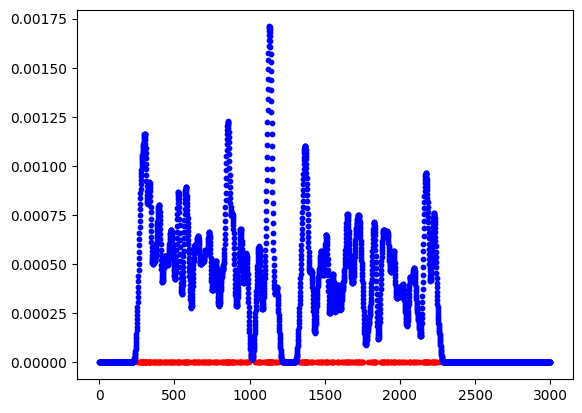

Y threshold kernel density plot


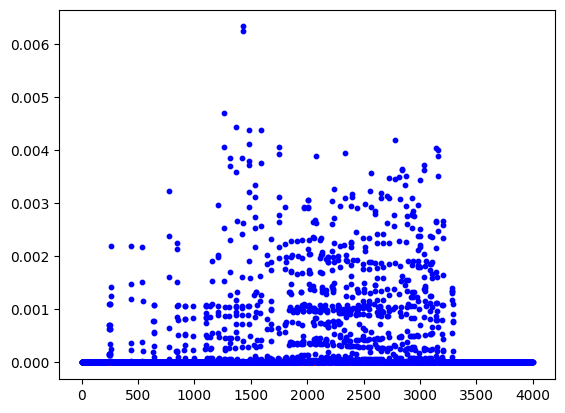

Thresholds are: [8, 469]
Image with boxes


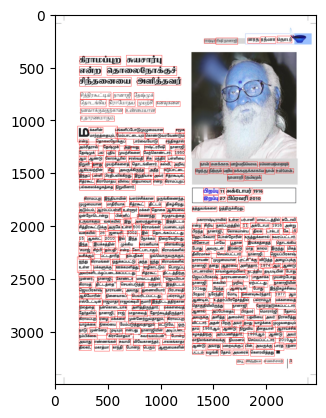

Final Result


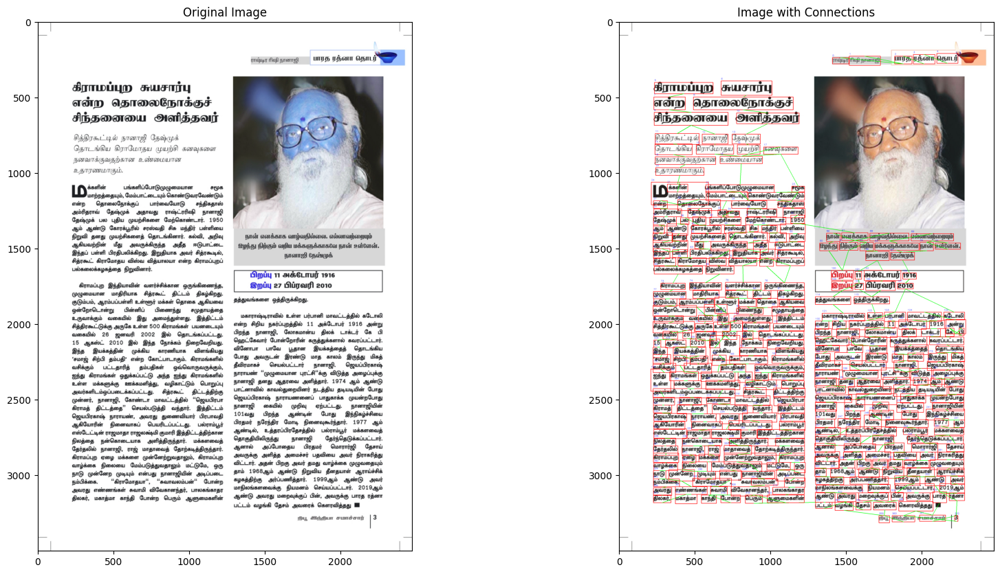

Config: [20, 5]
X threshold kernel density plot


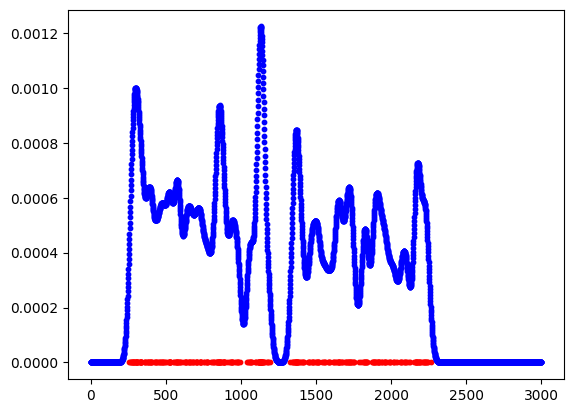

Y threshold kernel density plot


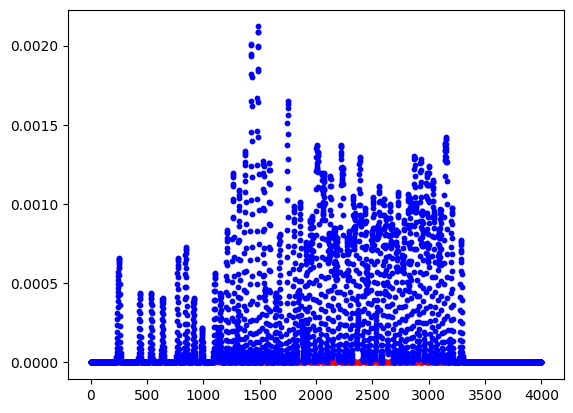

Thresholds are: [21, 971]
Image with boxes


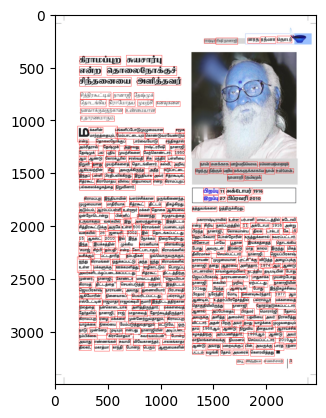

Final Result


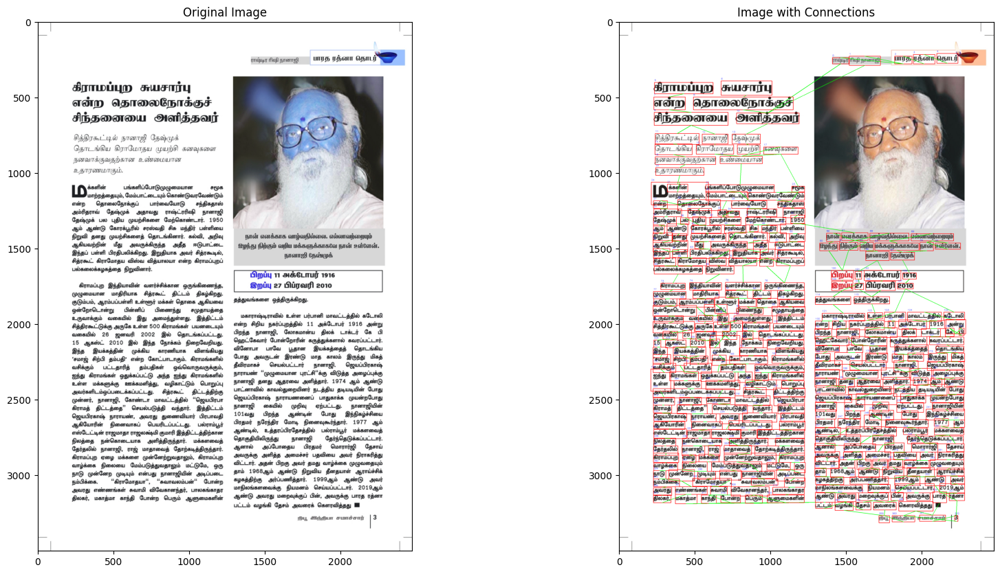

Config: [30, 10]
X threshold kernel density plot


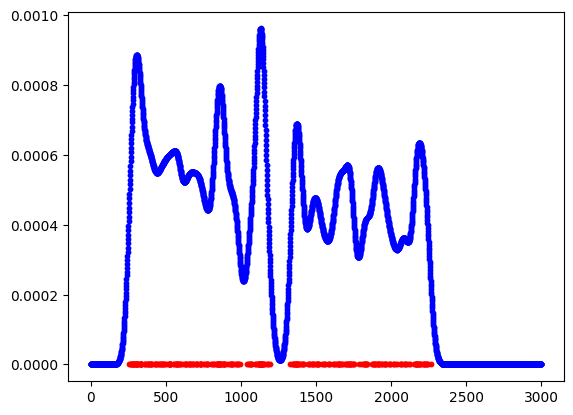

Y threshold kernel density plot


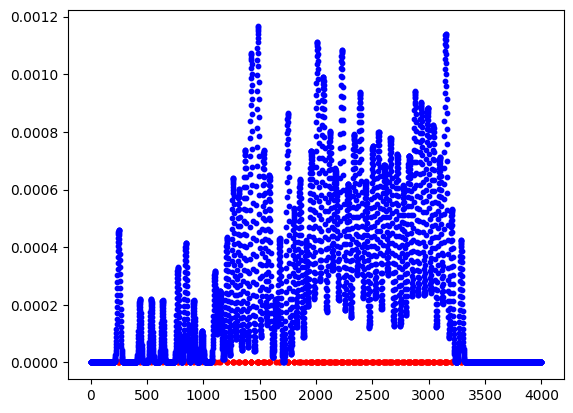

Thresholds are: [25, 992]
Image with boxes


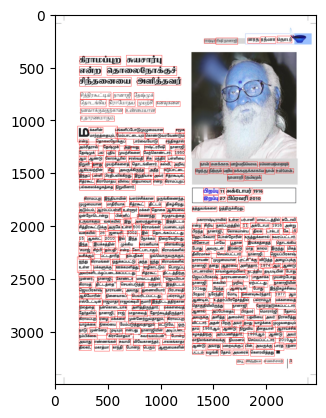

Final Result


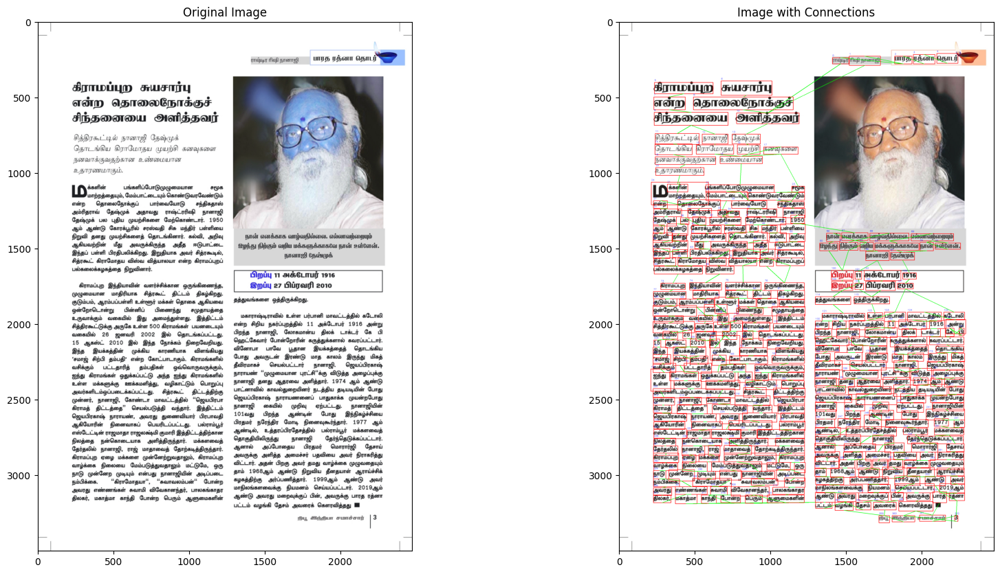

Config: [50, 20]
X threshold kernel density plot


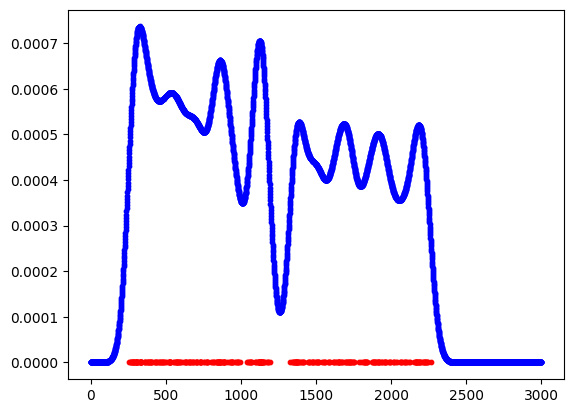

Y threshold kernel density plot


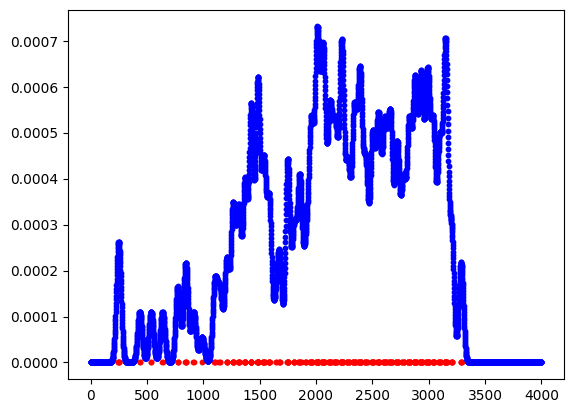

Thresholds are: [70, 2109]
Image with boxes


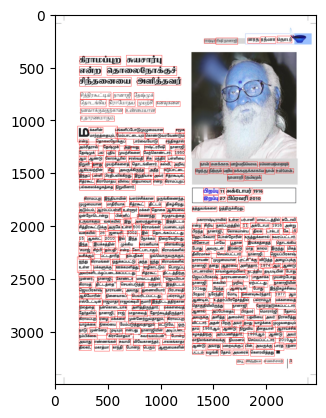

Final Result


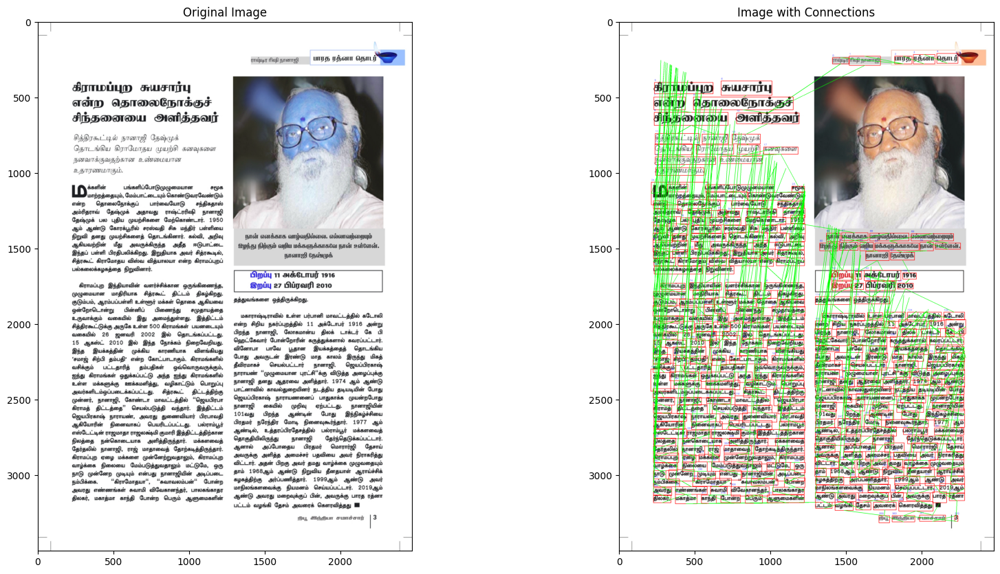

____________________________Image 232____________________________
Config: [10, 1]
X threshold kernel density plot


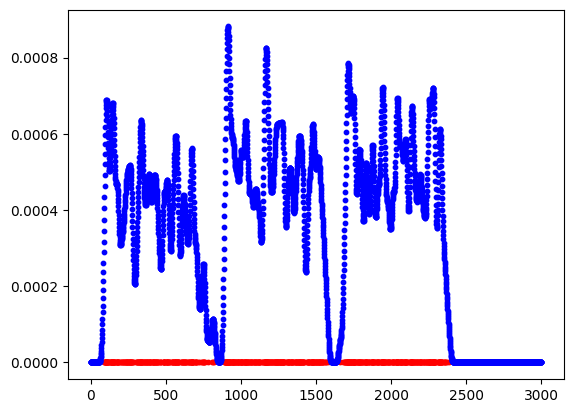

Y threshold kernel density plot


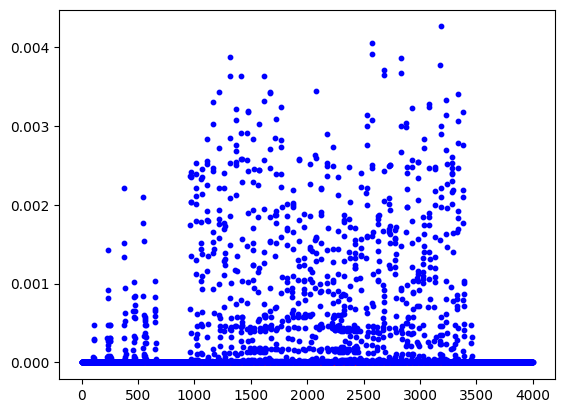

Thresholds are: [11, 529]
Image with boxes


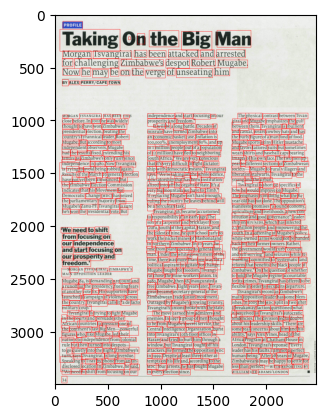

Final Result


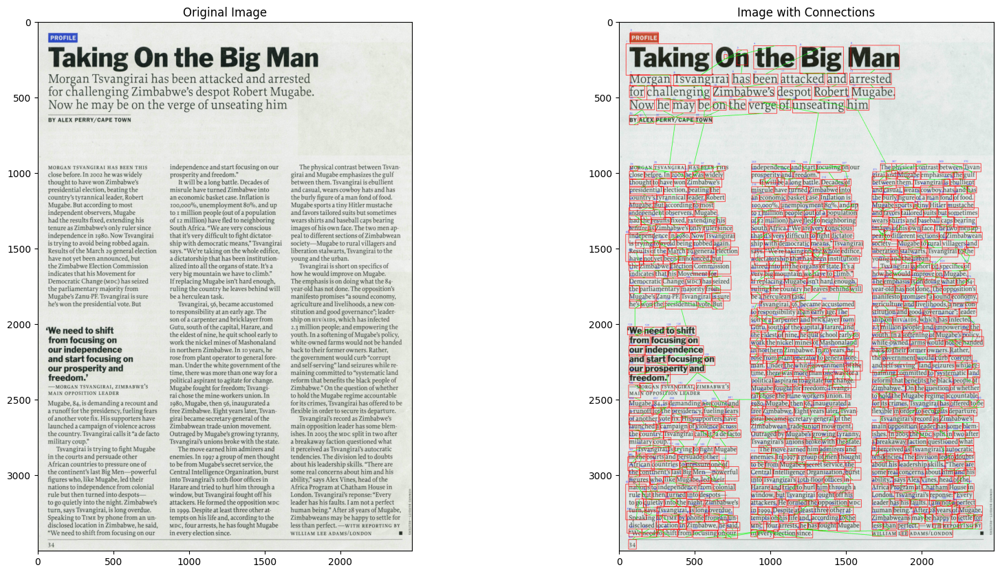

Config: [20, 5]
X threshold kernel density plot


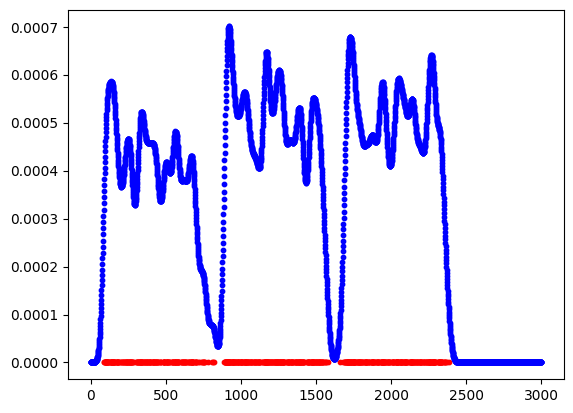

Y threshold kernel density plot


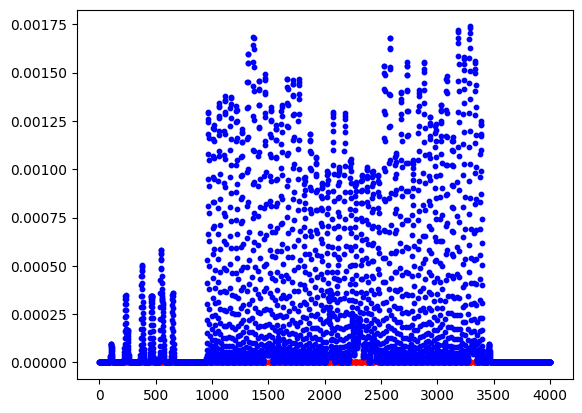

Thresholds are: [16, 717]
Image with boxes


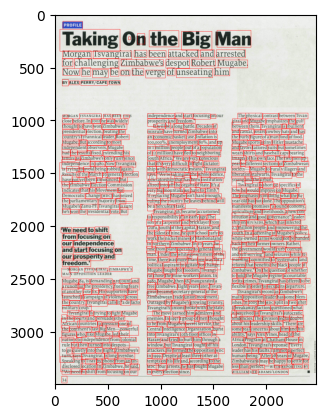

Final Result


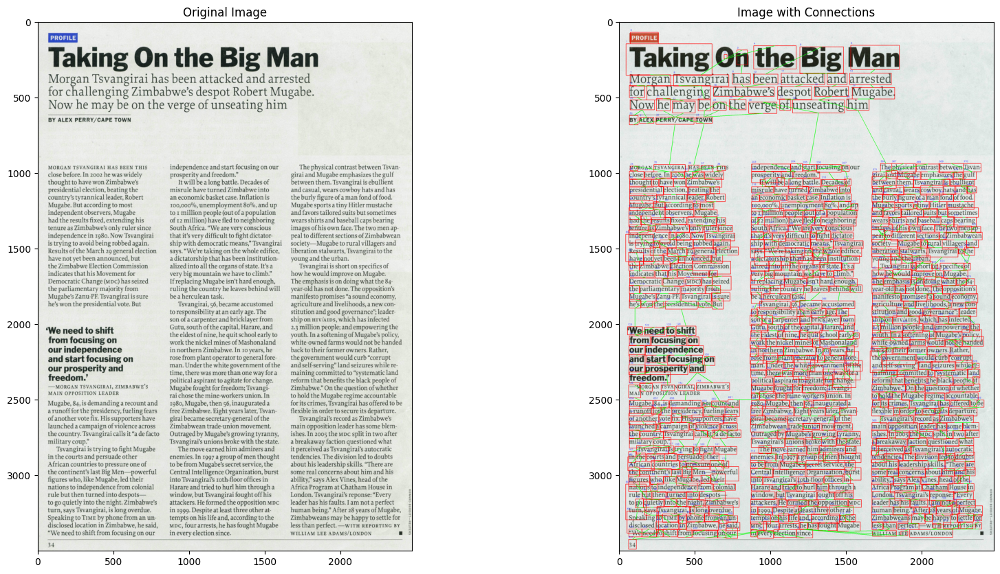

Config: [30, 10]
X threshold kernel density plot


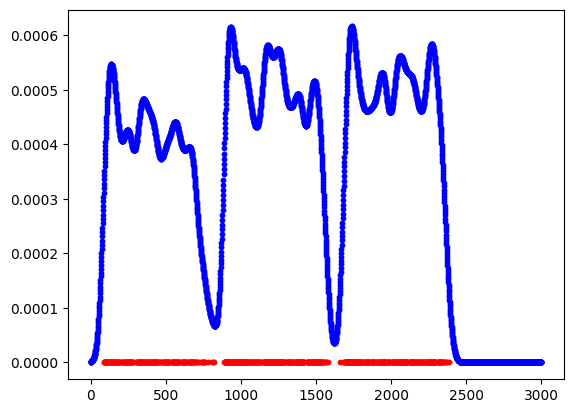

Y threshold kernel density plot


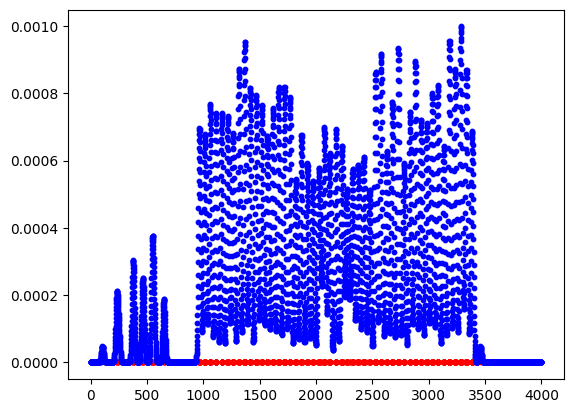

Thresholds are: [18, 737]
Image with boxes


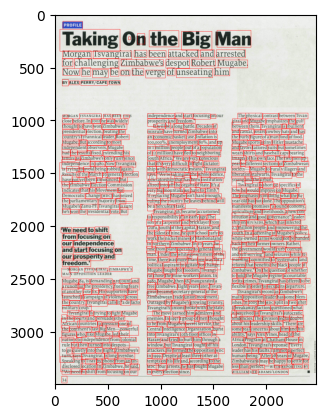

Final Result


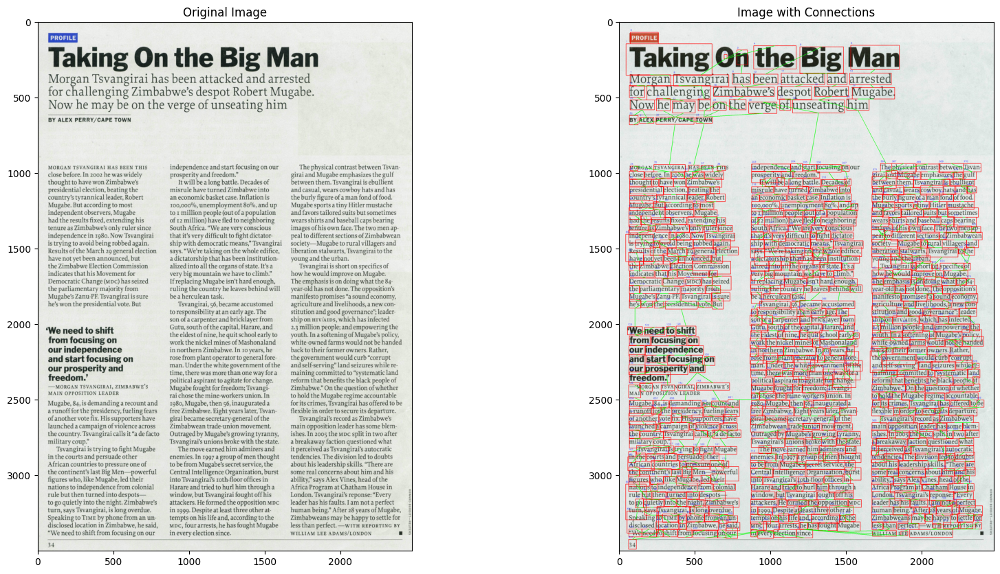

Config: [50, 20]
X threshold kernel density plot


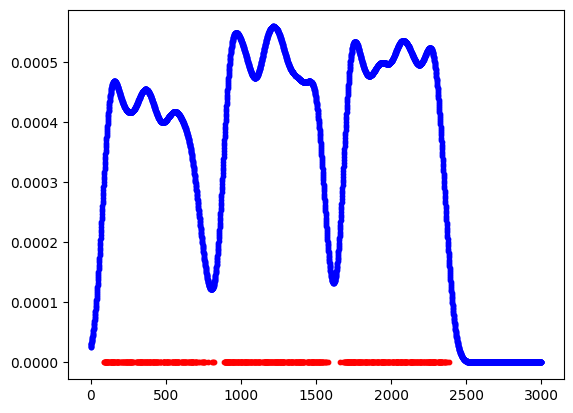

Y threshold kernel density plot


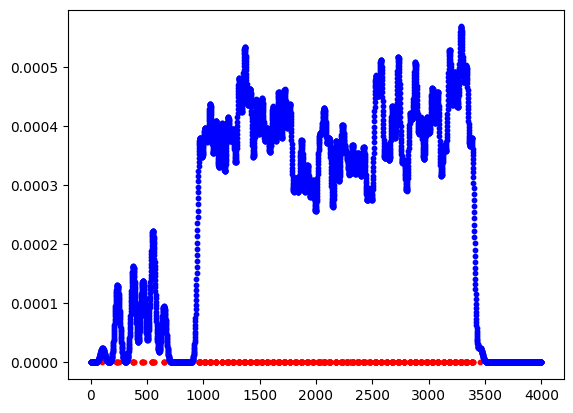

Thresholds are: [17, 2370]
Image with boxes


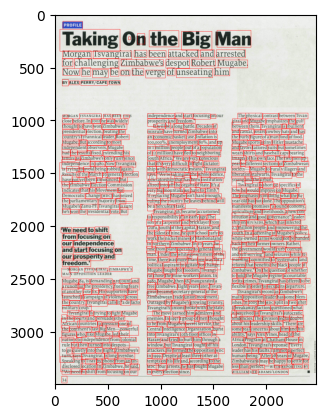

Final Result


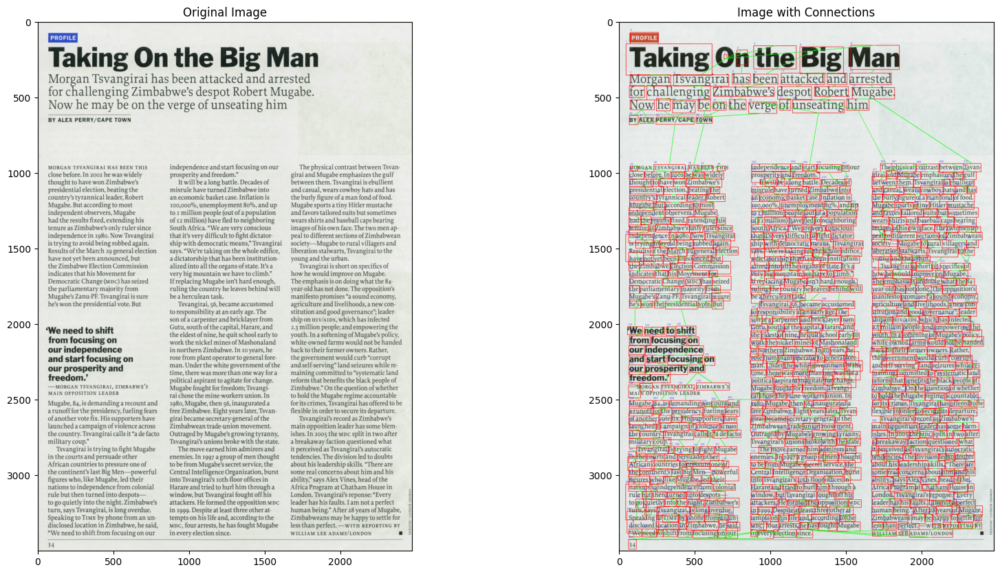

____________________________Image 250____________________________
Config: [10, 1]
X threshold kernel density plot


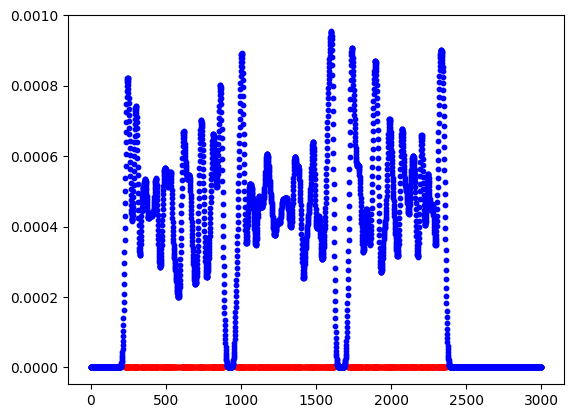

Y threshold kernel density plot


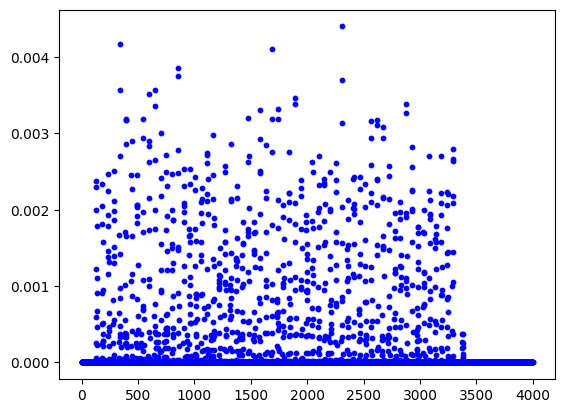

Thresholds are: [10, 673]
Image with boxes


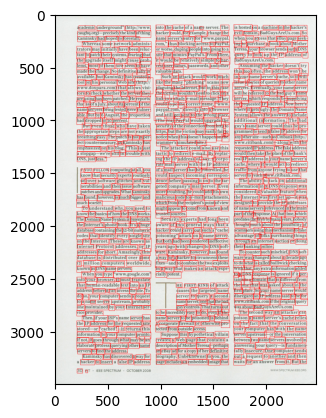

Final Result


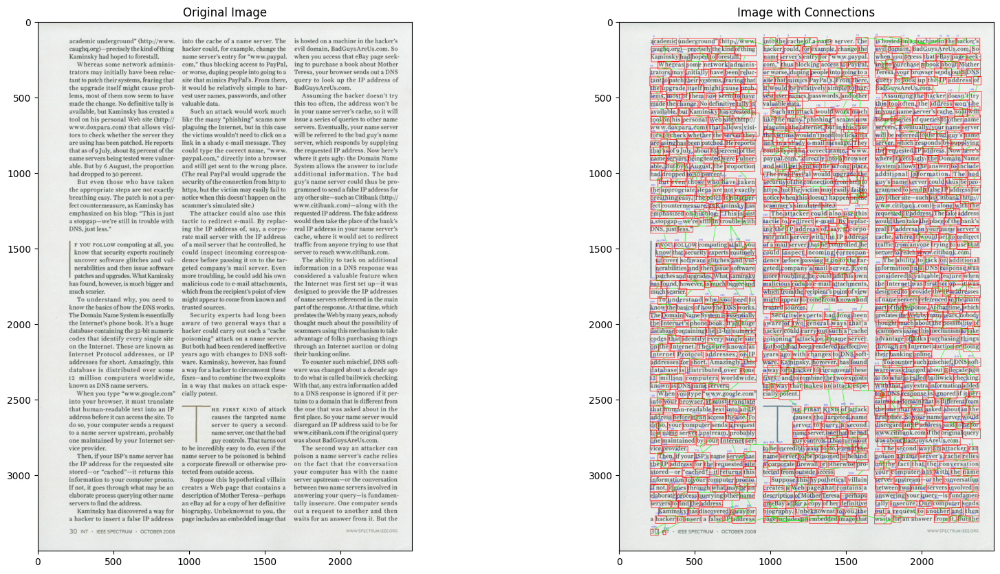

Config: [20, 5]
X threshold kernel density plot


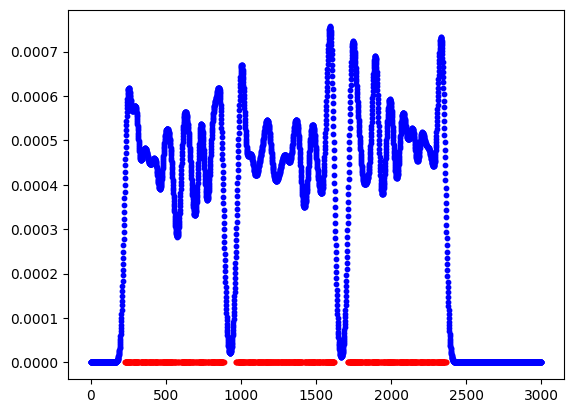

Y threshold kernel density plot


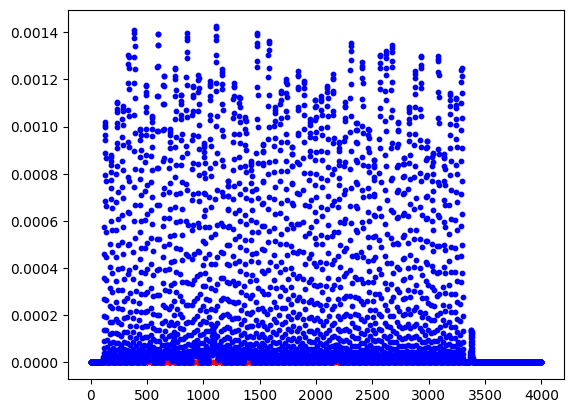

Thresholds are: [15, 695]
Image with boxes


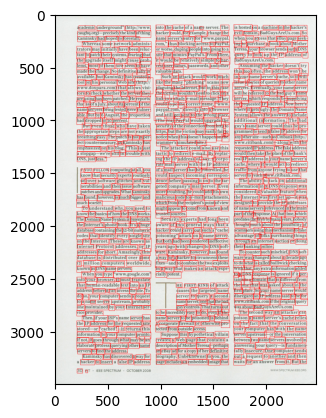

Final Result


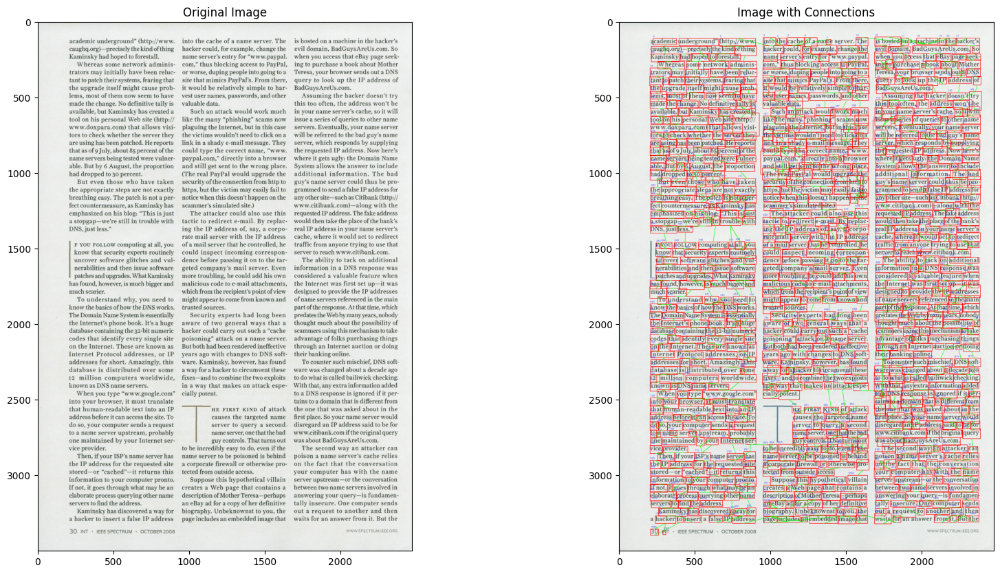

Config: [30, 10]
X threshold kernel density plot


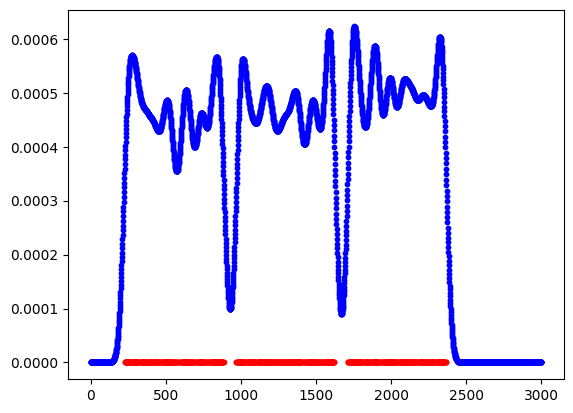

Y threshold kernel density plot


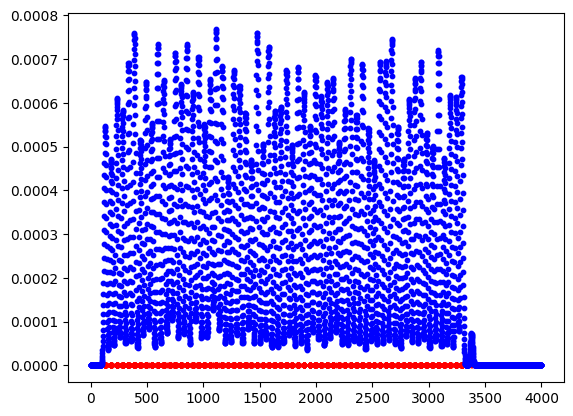

Thresholds are: [15, 727]
Image with boxes


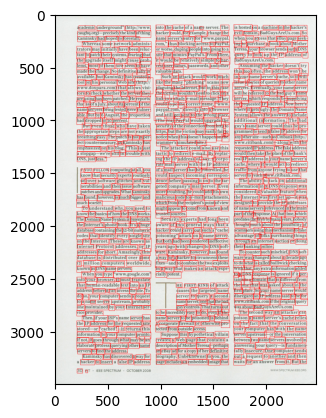

Final Result


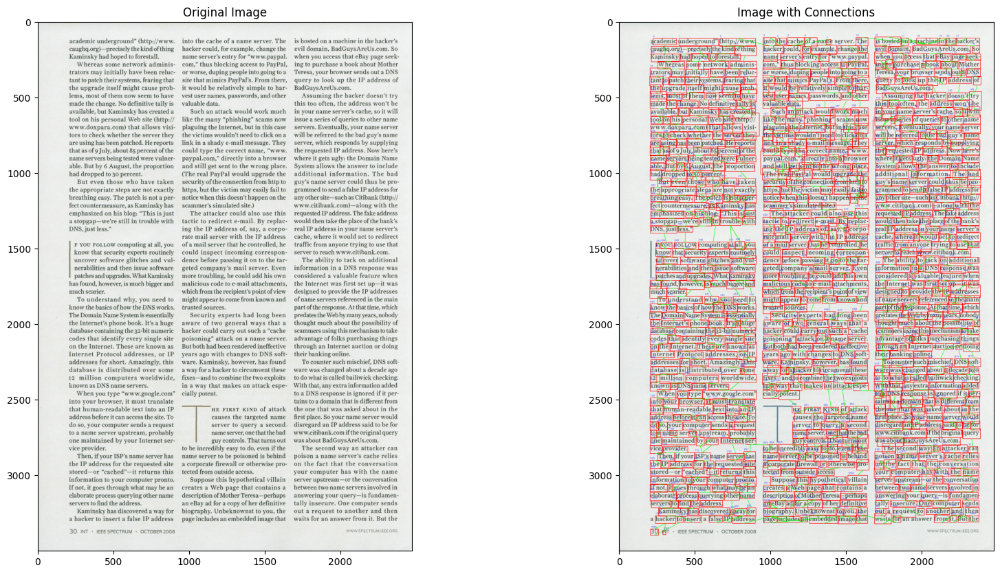

Config: [50, 20]
X threshold kernel density plot


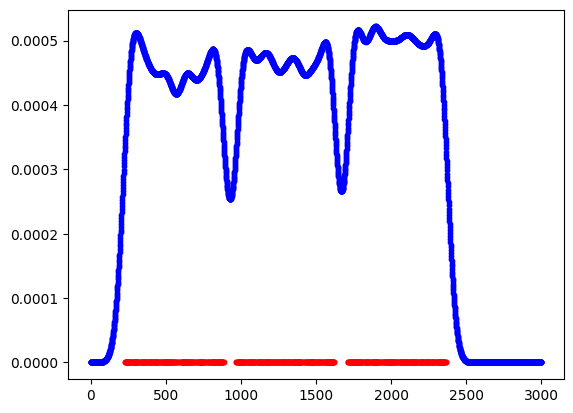

Y threshold kernel density plot


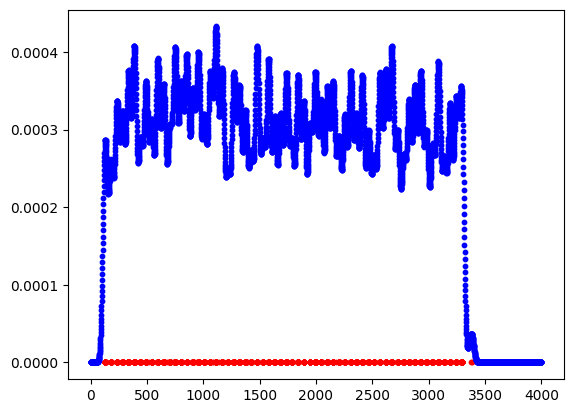

/Users/arjundosajh/opt/anaconda3/envs/myenv/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/arjundosajh/opt/anaconda3/envs/myenv/lib/python3.11/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Thresholds are: [-9223372036854775808, 2244]
Image with boxes


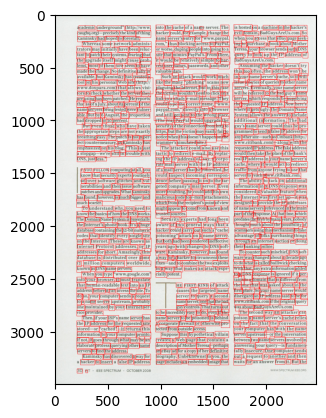

Final Result


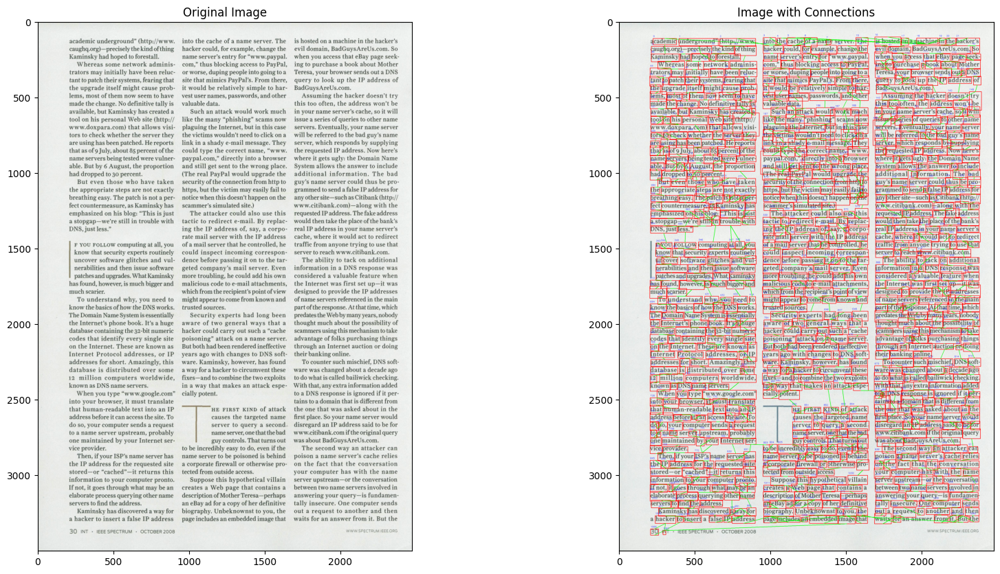

In [93]:
def process_images(img_names, x_bandwidth, y_bandwidth):
    for img_name in img_names:
        print(f"____________________________Image {img_name}____________________________")
        for x_bw, y_bw in zip(x_bandwidth, y_bandwidth):
            config = [x_bw, y_bw]
            print(f"Config: {config}")
            plotresults(config, img_name)

img_names = ['29', '68', '145', '201', '232', '250']
process_images(img_names, x_bandwidth, y_bandwidth)